In [1]:
%matplotlib inline
import pandas as pd
import sys
import datacube
import numpy as np
import matplotlib.pyplot as plt
from datacube.utils.cog import write_cog
from datacube.helpers import write_geotiff

sys.path.append("../Scripts")
from deafrica_plotting import display_map

from odc.ui import DcViewer
import boto3
import xarray as xr

In [2]:
dc = datacube.Datacube(app="aerosol")

In [3]:
#-33.74946228487084, -71.70166564905642
central_lat = -33.74946228487084
central_lon = -71.70166564905642

buffer = 0.1

study_area_lat = (central_lat - buffer, central_lat + buffer)
study_area_lon = (central_lon - buffer, central_lon + buffer)

In [4]:
display_map(x=study_area_lon, y=study_area_lat)

In [5]:
dc.list_products()[['name', 'description']] #usgs_espa_ls8c1_sr

,name,description
id,,
7,cophub_s2_sr_sen2cor,"Sentinel-2A/B ESA Surface Reflectance, process..."
1,usgs_espa_ls5c1_sr,Landsat 5 USGS Collection 1 Surface Reflectanc...
2,usgs_espa_ls7c1_sr,Landsat 7 USGS Collection 1 Surface Reflectanc...
5,usgs_espa_ls8c1_ar,Landsat 8 USGS Collection 1 Aquatic Reflectanc...
3,usgs_espa_ls8c1_sr,Landsat 8 USGS Collection 1 Surface Reflectanc...
6,usgs_espa_ls8c1_toa,Landsat 8 USGS Collection 1 TOA and Brightness...
4,usgs_espa_ls8c1_veg,Landsat 8 USGS Collection 1 Vegetation Indices...


In [6]:
dc.list_measurements()

name   dtype        units  \
product              measurement                                             
cophub_s2_sr_sen2cor coastal_aerosol  coastal_aerosol  uint16  reflectance   
                     blue                        blue  uint16  reflectance   
                     green                      green  uint16  reflectance   
                     red                          red  uint16  reflectance   
                     red_edge_1            red_edge_1  uint16  reflectance   
...                                               ...     ...          ...   
usgs_espa_ls8c1_toa  pixel_qa                pixel_qa  uint16    bit_index   
                     radsat_qa              radsat_qa  uint16    bit_index   
usgs_espa_ls8c1_veg  ndvi                        ndvi   int16            1   
                     evi                          evi   int16            1   
                     pixel_qa                pixel_qa  uint16    bit_index   

                                      nodata                     aliases  \
product              measurement                                           
cophub_s2_sr_sen2cor coastal_aerosol       0      [B01, B01_60m, band_1]   
                     blue                  0      [B02, B02_10m, band_2]   
                     green                 0      [B03, B03_10m, band_3]   
                     red                   0      [B04, B04_10m, band_4]   
                     red_edge_1            0      [B05, B05_20m, band_5]   
...                                      ...                         ...   
usgs_espa_ls8c1_toa  pixel_qa              1  [pixel_quality, level2_qa]   
                     radsat_qa             1             [saturation_qa]   
usgs_espa_ls8c1_veg  ndvi              -9999                   [sr_ndvi]   
                     evi               -9999                    [sr_evi]   
                     pixel_qa              1  [pixel_quality, level2_qa]   

                                                                       flags_definition  
product              measurement                                                         
cophub_s2_sr_sen2cor coastal_aerosol                                                NaN  
                     blue                                                           NaN  
                     green                                                          NaN  
                     red                                                            NaN  
                     red_edge_1                                                     NaN  
...                                                                                 ...  
usgs_espa_ls8c1_toa  pixel_qa         {'snow': {'bits': 4, 'values': {'0': 'no_snow'...  
                     radsat_qa        {'data_fill': {'bits': 0, 'values': {'0': 'val...  
usgs_espa_ls8c1_veg  ndvi                                                           NaN  
                     evi                                                            NaN  
                     pixel_qa         {'snow': {'bits': 4, 'values': {'0': 'no_snow'...  

[70 rows x 6 columns]

In [7]:
#x=(-33.5, -33.9),
ds = dc.load(product="usgs_espa_ls8c1_sr",
             x=study_area_lon,
             y=study_area_lat,
             output_crs = "EPSG:32719",
             time = ("2015-01-01", "2020-12-31"),
             resolution = (-25, 25),
             dask_chunks={"time": 1}
            )
ds

<xarray.Dataset>
Dimensions:          (time: 388, x: 766, y: 907)
Coordinates:
  * time             (time) datetime64[ns] 2015-01-03T14:39:53.636235 ... 202...
  * y                (y) float64 6.274e+06 6.274e+06 ... 6.251e+06 6.251e+06
  * x                (x) float64 2.402e+05 2.402e+05 ... 2.593e+05 2.593e+05
    spatial_ref      int32 32719
Data variables:
    coastal_aerosol  (time, y, x) int16 dask.array<chunksize=(1, 907, 766), meta=np.ndarray>
    blue             (time, y, x) int16 dask.array<chunksize=(1, 907, 766), meta=np.ndarray>
    green            (time, y, x) int16 dask.array<chunksize=(1, 907, 766), meta=np.ndarray>
    red              (time, y, x) int16 dask.array<chunksize=(1, 907, 766), meta=np.ndarray>
    nir              (time, y, x) int16 dask.array<chunksize=(1, 907, 766), meta=np.ndarray>
    swir1            (time, y, x) int16 dask.array<chunksize=(1, 907, 766), meta=np.ndarray>
    swir2            (time, y, x) int16 dask.array<chunksize=(1, 907, 766), meta=np.ndarray>
    pixel_qa         (time, y, x) uint16 dask.array<chunksize=(1, 907, 766), meta=np.ndarray>
    aerosol_qa       (time, y, x) uint8 dask.array<chunksize=(1, 907, 766), meta=np.ndarray>
    radsat_qa        (time, y, x) uint16 dask.array<chunksize=(1, 907, 766), meta=np.ndarray>
Attributes:
    crs:           EPSG:32719
    grid_mapping:  spatial_ref

In [8]:
ds.coastal_aerosol

<xarray.DataArray 'coastal_aerosol' (time: 388, y: 907, x: 766)>
dask.array<dc_load_coastal_aerosol, shape=(388, 907, 766), dtype=int16, chunksize=(1, 907, 766), chunktype=numpy.ndarray>
Coordinates:
  * time         (time) datetime64[ns] 2015-01-03T14:39:53.636235 ... 2020-08...
  * y            (y) float64 6.274e+06 6.274e+06 ... 6.251e+06 6.251e+06
  * x            (x) float64 2.402e+05 2.402e+05 ... 2.593e+05 2.593e+05
    spatial_ref  int32 32719
Attributes:
    units:         reflectance
    nodata:        -9999
    crs:           EPSG:32719
    grid_mapping:  spatial_ref

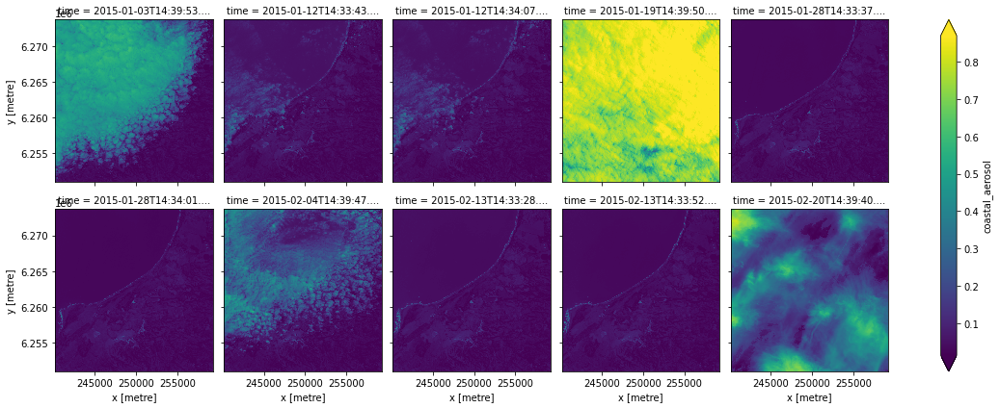

In [9]:
scaled_ds = ds.coastal_aerosol[:10]*0.0001
scaled_ds.plot(col="time", robust=True, col_wrap=5)

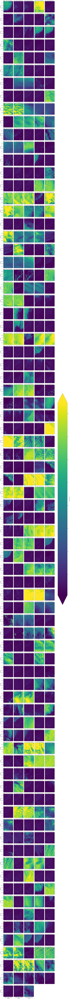

In [10]:
scaled_ds = ds.coastal_aerosol*0.0001
scaled_ds.plot(col="time", robust=True, col_wrap=5)

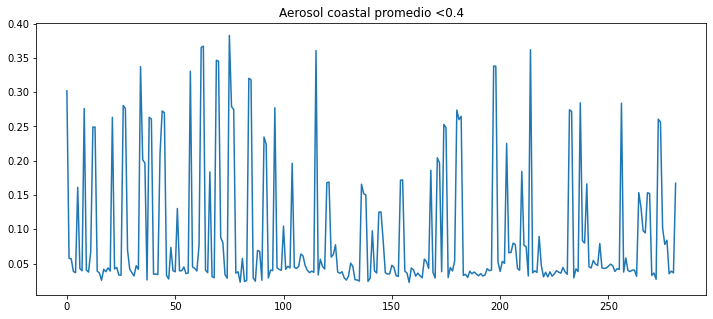

In [11]:
ds_coastal_aerosol = ds.coastal_aerosol*0.0001
medias = ds_coastal_aerosol.mean(axis=[1,2]).values
medias4 = [x for x in medias if (x <0.4)]
plt.figure(figsize=(12,5))
plt.title("Aerosol coastal promedio <0.4")
plt.plot(medias4)

In [12]:
ds_coastal_aerosol = ds.coastal_aerosol*0.0001
medias = ds_coastal_aerosol.mean(axis=[1,2]).values

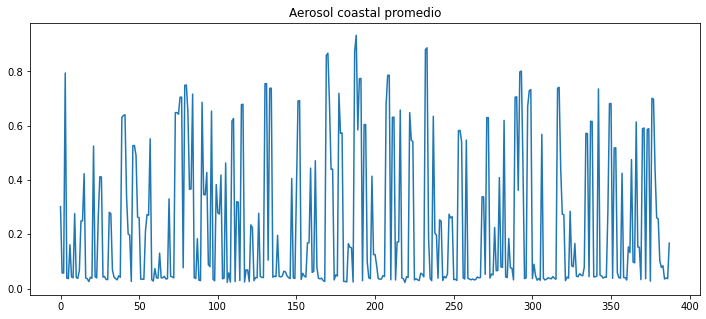

In [13]:
plt.figure(figsize=(12,5))
plt.title("Aerosol coastal promedio")
plt.plot(medias)

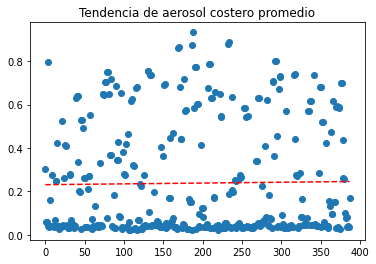

In [14]:
x_plot = [indice for indice in range(len(medias))]
plt.scatter(x_plot, medias)
z = np.polyfit(x_plot, medias, 1)
p = np.poly1d(z)
plt.plot(x_plot, p(x_plot),"r--")
#print(len(medias), len(medias))
plt.title("Tendencia de aerosol costero promedio")
plt.show()

In [15]:
s3 = boto3.client("s3")

In [16]:
bucket = "hackathon-fach-2020"

In [17]:
objects = s3.list_objects(Bucket=bucket)
parsed_objects = pd.DataFrame(objects["Contents"])
parsed_objects.sort_values("Key")

,Key,LastModified,ETag,Size,StorageClass
0,dmc_valparaiso/L-3/Thumbs.db,2020-12-07 12:25:11+00:00,"""b5b72ea17098f86921be534b10ea2891""",540160,STANDARD
1,dmc_valparaiso/L-3/Valpo250619_003~0003_rgb.tif,2020-12-07 12:25:20+00:00,"""13dec84b895a95b24fffd3862d4f65f5-8""",60438358,STANDARD
2,dmc_valparaiso/L-3/Valpo250619_003~0004_rgb.tif,2020-12-07 12:25:15+00:00,"""d9a8da7bed9743d8c567b3ede0061973-8""",61302470,STANDARD
3,dmc_valparaiso/L-3/Valpo250619_003~0005_rgb.tif,2020-12-07 12:25:12+00:00,"""6add094b1d3989fa077ab93337e32a7f-8""",63971382,STANDARD
4,dmc_valparaiso/L-3/Valpo250619_003~0006_rgb.tif,2020-12-07 12:25:12+00:00,"""c7c8659ffa5703dd155d1e3e13c3e20e-8""",65805958,STANDARD
...,...,...,...,...,...
770,ultracam/incendios/6.tif,2020-12-07 12:27:23+00:00,"""1825c78cdbd113f4200b5943593831fd-220""",1839349020,STANDARD
771,ultracam/incendios/7.tfw,2020-12-07 12:26:50+00:00,"""20c6206cbb65aaaa396511011962c2ed""",74,STANDARD
772,ultracam/incendios/7.tif,2020-12-07 12:28:34+00:00,"""8612df0aad5c4ee98d434d9143b1b31a-220""",1839349020,STANDARD
773,ultracam/incendios/8.tfw,2020-12-07 12:27:22+00:00,"""da049d34697145f8631853852bbaabd7""",74,STANDARD


In [18]:
for key in parsed_objects.sort_values("Key")["Key"]:
    if ("humedal" in key): print(key)

humedal/yali_3a_ms.tfw
humedal/yali_3a_ms.tif
humedal/yali_3a_pan.tfw
humedal/yali_3a_pan.tif
ultracam/humedales/10.tfw
ultracam/humedales/10.tif
ultracam/humedales/11.tfw
ultracam/humedales/11.tif
ultracam/humedales/12.tfw
ultracam/humedales/12.tif
ultracam/humedales/13.tfw
ultracam/humedales/13.tif
ultracam/humedales/14.tfw
ultracam/humedales/14.tif
ultracam/humedales/15.tfw
ultracam/humedales/15.tif
ultracam/humedales/16.tfw
ultracam/humedales/16.tif
ultracam/humedales/17.tfw
ultracam/humedales/17.tif
ultracam/humedales/18.tfw
ultracam/humedales/18.tif
ultracam/humedales/19.tfw
ultracam/humedales/19.tif
ultracam/humedales/20.tfw
ultracam/humedales/20.tif
ultracam/humedales/21.tfw
ultracam/humedales/21.tif
ultracam/humedales/22.tfw
ultracam/humedales/22.tif
ultracam/humedales/9.tfw
ultracam/humedales/9.tif


In [19]:
file = "humedal/yali_3a_pan.tif"
file_path = f's3://{bucket}/{file}'
file_path

's3://hackathon-fach-2020/humedal/yali_3a_pan.tif'

In [20]:
da = xr.open_rasterio(file_path, chunks={'x': 500, 'y': 500})
da

,Array,Chunk
Bytes,241.17 MB,500.00 kB
Shape,"(1, 11626, 10372)","(1, 500, 500)"
Count,505 Tasks,504 Chunks
Type,uint16,numpy.ndarray


In [21]:
print(min(da.x), '\n\n', da.x)

<xarray.DataArray 'x' ()>
array(244254.)
Coordinates:
    x        float64 2.443e+05 

 <xarray.DataArray 'x' (x: 10372)>
array([244254.  , 244255.45, 244256.9 , ..., 259289.05, 259290.5 , 259291.95])
Coordinates:
  * x        (x) float64 2.443e+05 2.443e+05 2.443e+05 ... 2.593e+05 2.593e+05


In [22]:
print(min(da.x).values + max(da.x).values)
print(min(da.y).values)
print(max(da.y).values)
print(min(da.x).values)
print(max(da.x).values)

503545.94999999995
6245384.75
6262241.0
244254.0
259291.94999999998


In [23]:
#slice_data = da.sel(band=1, y=slice(*study_area_lon), x=slice(*study_area_lat))
#slice_data = da.sel(band=1, y=slice(*(6262241.  , 6262239.55)), x=slice(*(244254.  , 244255.45)))   #-33.74   &   -71.70
lat_min = min(da.y).values
lat_max = max(da.y).values
lon_min = min(da.x).values
lon_max = max(da.x).values
recorte_lat = 1.5
recorte_lon = 1.5
slice_data = da.sel(band=1, y=slice(*(lat_max - (lat_max - lat_min)/recorte_lat, lat_min)), x=slice(*(lon_min, lon_max - (lon_max - lon_min)/recorte_lon)))
slice_data

<xarray.DataArray (y: 3876, x: 3458)>
dask.array<getitem, shape=(3876, 3458), dtype=uint16, chunksize=(500, 500), chunktype=numpy.ndarray>
Coordinates:
    band     int64 1
  * y        (y) float64 6.251e+06 6.251e+06 6.251e+06 ... 6.245e+06 6.245e+06
  * x        (x) float64 2.443e+05 2.443e+05 2.443e+05 ... 2.493e+05 2.493e+05
Attributes:
    transform:               (1.45, 0.0, 244253.275, 0.0, -1.45, 6262241.725)
    crs:                     +init=epsg:32719
    res:                     (1.45, 1.45)
    is_tiled:                1
    nodatavals:              (nan,)
    scales:                  (1.0,)
    offsets:                 (0.0,)
    AREA_OR_POINT:           Area
    TIFFTAG_RESOLUTIONUNIT:  2 (pixels/inch)
    TIFFTAG_SOFTWARE:        ERDAS IMAGINE
    TIFFTAG_XRESOLUTION:     1
    TIFFTAG_YRESOLUTION:     1

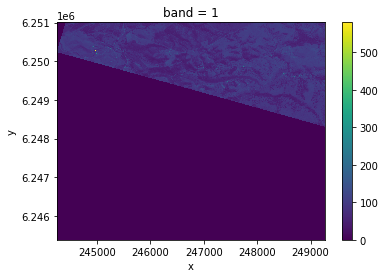

In [24]:
slice_data = slice_data.load()
slice_data.plot()

In [25]:
ds = dc.load(product="usgs_espa_ls8c1_ar",
             x=study_area_lon,
             y=study_area_lat,
             output_crs = "EPSG:32719",
             time = ("2015-01-01", "2020-12-31"),
             resolution = (-25, 25),
             dask_chunks={"time": 1}
            )
ds

<xarray.Dataset>
Dimensions:          (time: 144, x: 766, y: 907)
Coordinates:
  * time             (time) datetime64[ns] 2015-01-12T14:33:43.163960 ... 202...
  * y                (y) float64 6.274e+06 6.274e+06 ... 6.251e+06 6.251e+06
  * x                (x) float64 2.402e+05 2.402e+05 ... 2.593e+05 2.593e+05
    spatial_ref      int32 32719
Data variables:
    coastal_aerosol  (time, y, x) int16 dask.array<chunksize=(1, 907, 766), meta=np.ndarray>
    blue             (time, y, x) int16 dask.array<chunksize=(1, 907, 766), meta=np.ndarray>
    green            (time, y, x) int16 dask.array<chunksize=(1, 907, 766), meta=np.ndarray>
    red              (time, y, x) int16 dask.array<chunksize=(1, 907, 766), meta=np.ndarray>
    pixel_qa         (time, y, x) uint16 dask.array<chunksize=(1, 907, 766), meta=np.ndarray>
    ar_flags         (time, y, x) int32 dask.array<chunksize=(1, 907, 766), meta=np.ndarray>
Attributes:
    crs:           EPSG:32719
    grid_mapping:  spatial_ref

In [26]:
ds = dc.load(product="usgs_espa_ls8c1_sr",
             x=study_area_lon,
             y=study_area_lat,
             output_crs = "EPSG:32719",
             time = ("2015-01-01", "2020-12-31"),
             resolution = (-25, 25),
             dask_chunks={"time": 1}
            )
ds

<xarray.Dataset>
Dimensions:          (time: 388, x: 766, y: 907)
Coordinates:
  * time             (time) datetime64[ns] 2015-01-03T14:39:53.636235 ... 202...
  * y                (y) float64 6.274e+06 6.274e+06 ... 6.251e+06 6.251e+06
  * x                (x) float64 2.402e+05 2.402e+05 ... 2.593e+05 2.593e+05
    spatial_ref      int32 32719
Data variables:
    coastal_aerosol  (time, y, x) int16 dask.array<chunksize=(1, 907, 766), meta=np.ndarray>
    blue             (time, y, x) int16 dask.array<chunksize=(1, 907, 766), meta=np.ndarray>
    green            (time, y, x) int16 dask.array<chunksize=(1, 907, 766), meta=np.ndarray>
    red              (time, y, x) int16 dask.array<chunksize=(1, 907, 766), meta=np.ndarray>
    nir              (time, y, x) int16 dask.array<chunksize=(1, 907, 766), meta=np.ndarray>
    swir1            (time, y, x) int16 dask.array<chunksize=(1, 907, 766), meta=np.ndarray>
    swir2            (time, y, x) int16 dask.array<chunksize=(1, 907, 766), meta=np.ndarray>
    pixel_qa         (time, y, x) uint16 dask.array<chunksize=(1, 907, 766), meta=np.ndarray>
    aerosol_qa       (time, y, x) uint8 dask.array<chunksize=(1, 907, 766), meta=np.ndarray>
    radsat_qa        (time, y, x) uint16 dask.array<chunksize=(1, 907, 766), meta=np.ndarray>
Attributes:
    crs:           EPSG:32719
    grid_mapping:  spatial_ref

In [ ]:
#Ndwi2 = (ds.green - ds.nir)/(ds.green*ds.green + ds.nir*ds.nir + 0.001)
Ndwi = (ds.green - ds.nir)/(ds.green + ds.nir)
Mndwi = (ds.green - ds.swir1)/(ds.green + ds.swir1)
medias_a = Ndwi.mean(axis=[1,2]).values
medias_b = Mndwi.mean(axis=[1,2]).values

/env/lib/python3.6/site-packages/dask/core.py:121: RuntimeWarning: divide by zero encountered in true_divide
  return func(*(_execute_task(a, cache) for a in args))


In [ ]:
plt.figure(figsize=(12, 5))
plt.title("Ndwi")
plt.plot(medias_a)

In [ ]:
plt.figure(figsize=(12, 5))
plt.title("Mndwi")
plt.plot(medias_b)

In [ ]:
medias_de_interés_xmes = []
Ndwi_temporal = []
mes_anterior = 0
año_anterior = 0
for x0 in Ndwi:
    x_actual = x0.values
    mes_actual = int(str(x0["time"].values)[5:7])
    año_actual = int(str(x0["time"].values)[:4])
    if (mes_anterior == mes_actual) and (año_anterior == año_actual):
        for x1 in range(454):
            for x2 in range(383):
                if (x2 + x1 >= 355): Ndwi_temporal += [x_actual[x1,x2]]
    else:
        mes_anterior = mes_actual
        año_anterior = año_actual
        if (len(Ndwi_temporal) >= 1): medias_de_interés_xmes += [sum(Ndwi_temporal)/len(Ndwi_temporal)]
        Ndwi_temporal = []
        for x1 in range(454):
            for x2 in range(383):
                if (x2 + x1 >= 355): Ndwi_temporal += [x_actual[x1,x2]]
    print(mes_actual, año_actual)
    print(len(medias_de_interés_xmes))
medias_de_interés_xmes += [sum(Ndwi_temporal)/len(Ndwi_temporal)]
# print(medias_de_interés_xmes)
# print(len(medias_de_interés_xmes))

In [ ]:
plt.figure(figsize=(12, 5))
plt.title("Ndwi por mes")
plt.plot(medias_de_interés_xmes)

In [ ]:
medias_de_interés_xmes_sinna = []
Ndwi_temporal = []
mes_anterior = 0
año_anterior = 0
for x0 in Ndwi.dropna():
    x_actual = x0.values
    mes_actual = int(str(x0["time"].values)[5:7])
    año_actual = int(str(x0["time"].values)[:4])
    if (mes_anterior == mes_actual) and (año_anterior == año_actual):
        for x1 in range(454):
            for x2 in range(383):
                if (x2 + x1 >= 355): Ndwi_temporal += [x_actual[x1,x2]]
    else:
        mes_anterior = mes_actual
        año_anterior = año_actual
        if (len(Ndwi_temporal) >= 1): medias_de_interés_xmes_sinna += [sum(Ndwi_temporal)/len(Ndwi_temporal)]
        Ndwi_temporal = []
        for x1 in range(454):
            for x2 in range(383):
                if (x2 + x1 >= 355): Ndwi_temporal += [x_actual[x1,x2]]
    print(mes_actual, año_actual)
    print(len(medias_de_interés_xmes))
medias_de_interés_xmes_sinna += [sum(Ndwi_temporal)/len(Ndwi_temporal)]
print(medias_de_interés_xmes_sinna)
print(len(medias_de_interés_xmes_sinna))

In [ ]:
medias_de_interés_xmes_sinna = [incom for incom in medias_de_interés_xmes if str(incom) != 'nan']
plt.figure(figsize=(12, 5))
plt.title("Ndwi por mes")
plt.plot(medias_de_interés_xmes_sinna)

In [ ]:
#Veamos la situación por año
medias_de_interés_xaño = []
ndvi_temporal = []
año_anterior = 0
for x0 in Ndwi:
    x_actual = x0.values
    año_actual = int(str(x0["time"].values)[:4])
    if (año_anterior == año_actual):
        for x1 in range(454):
            for x2 in range(383):
                if (x2 + x1 >= 355): ndvi_temporal += [x_actual[x1,x2]]
    else:
        año_anterior = año_actual
        if (len(ndvi_temporal) >= 1): medias_de_interés_xaño += [sum(ndvi_temporal)/len(ndvi_temporal)]
        ndvi_temporal = []
        for x1 in range(454):
            for x2 in range(383):
                if (x2 + x1 >= 355): ndvi_temporal += [x_actual[x1,x2]]
medias_de_interés_xaño += [sum(ndvi_temporal)/len(ndvi_temporal)]
plt.figure(figsize=(12, 5))
plt.title("Ndvi promedio terrestre por año")
plt.plot(medias_de_interés_xaño)

In [ ]:
#x = [np.round(medias_a[indice],4) for indice in range(388) if ((str(medias_a[indice]) is "nan") and str(medias_a[indice]) is "inf") and str(medias_a[indice]) is "-inf")]
x = [np.round(indice,4) for indice in medias_a if (str(indice) is "inf")]
x_plot = [indice for indice in range(len(x))]
plt.scatter(x_plot, x)
z = np.polyfit(x_plot, x, 1)
p = np.poly1d(z)
plt.plot(x_plot, p(x_plot),"r--")
# print(len(medias_a), len(x))
plt.title("Tendencia de ndwi promedio")
plt.show()